In [1]:
PYTHON_PATHS = ["..", "/home/mikhail/research/d2-net/lib", "/home/mikhail/research/d2-net"]
import sys
for path in PYTHON_PATHS:
    if path not in sys.path:
        sys.path.append(path)

In [2]:
from unsupkeypoints.data.kapture_data import KaptureData
import numpy as np
import os
from tqdm.notebook import tqdm as tqdm
import matplotlib.pyplot as plt

In [3]:
ROOT_PATH = os.path.dirname(os.getcwd())

In [5]:
MODEL_FILE = "/home/mikhail/research/d2-net/models/d2_ots.pth"
# OUTPUT_KAPTURE_PATH = os.path.join(ROOT_PATH, "data/output_kapture/7scenes/fire/mapping")
OUTPUT_KAPTURE_PATH = os.path.join(ROOT_PATH, "data/output_kapture/7scenes/fire/mapping_superpoint")
# INPUT_KAPTURE_PATH = os.path.join(ROOT_PATH, "data/kapture/7scenes/fire/mapping")
IMAGE_PATH = os.path.join("/home/mikhail/research/lie-pose-net/data/7scenes/fire/")
# KAPTURE_DATA = KaptureData.load_from(INPUT_KAPTURE_PATH, OUTPUT_KAPTURE_PATH, IMAGE_PATH)
KAPTURE_DATA = KaptureData.load_from(OUTPUT_KAPTURE_PATH, OUTPUT_KAPTURE_PATH, IMAGE_PATH)

# Make descriptor vector

In [6]:
from kapture.io.features import get_descriptors_fullpath, get_keypoints_fullpath, \
    image_descriptors_from_file, image_keypoints_from_file
import kapture

In [7]:
image_list = [filename for _, _, filename in kapture.flatten(KAPTURE_DATA.records_camera)]
DESCRIPTORS_FULL = []
KEYPOITNS_FULL = []
KEYPOINTS_3D = []
KEYPOINTS_MASK = []
image_indexes = {}
for i, image_path in enumerate(image_list):
    descriptors_fullpath = get_descriptors_fullpath(KAPTURE_DATA.kapture_path, image_path)
    DESCRIPTORS_FULL.append(image_descriptors_from_file(descriptors_fullpath, KAPTURE_DATA.descriptors.dtype, 
                                                  KAPTURE_DATA.descriptors.dsize))
    keypoints_fullpath = get_keypoints_fullpath(KAPTURE_DATA.kapture_path, image_path)
    KEYPOITNS_FULL.append(image_keypoints_from_file(keypoints_fullpath, KAPTURE_DATA.keypoints.dtype, 
                                                  KAPTURE_DATA.keypoints.dsize))
    KEYPOINTS_3D.append(np.zeros((len(KEYPOITNS_FULL[i]), 3), dtype=np.float32))
    KEYPOINTS_MASK.append(np.zeros(len(KEYPOITNS_FULL[i]), dtype=np.bool))
    image_indexes[image_path] = i

for point_index, observation in KAPTURE_DATA.observations.items():
    if len(observation) > 10:
        for observation_image_name, image_keypoints_index in observation:
            image_index = image_indexes[observation_image_name]
            KEYPOINTS_MASK[image_index][image_keypoints_index] = True
            KEYPOINTS_3D[image_index][image_keypoints_index] = KAPTURE_DATA.points3d[point_index][:3]

In [8]:
final_points3d = []
final_descriptors = []
final_points2d = []
for point_index, observation in KAPTURE_DATA.observations.items():
    if len(observation) > 10:
        for image_name, image_keypoints_index in observation:
            image_index = image_indexes[image_name]
            final_points3d.append(KAPTURE_DATA.points3d[point_index, :3])
            final_descriptors.append(DESCRIPTORS_FULL[image_index][image_keypoints_index])
            final_points2d.append(KEYPOITNS_FULL[image_index][image_keypoints_index])
DESCRIPTORS = np.array(final_descriptors)
POINTS = np.array(final_points3d)
print(DESCRIPTORS.shape)

(784770, 256)


# Linear regression

In [9]:
from sklearn.linear_model import LinearRegression, Ridge, BayesianRidge
from sklearn.model_selection import train_test_split

In [10]:
def make_regression(x, keypoints, regression_class, **kwargs):
    point_x, point_y, point_z = keypoints.T
    model_x = regression_class(**kwargs).fit(x, point_x)
    print("train x score = {}".format(model_x.score(x, point_x)))
    model_y = regression_class(**kwargs).fit(x, point_y)
    print("train y score = {}".format(model_y.score(x, point_y)))
    model_z = regression_class(**kwargs).fit(x, point_z)
    print("train z score = {}".format(model_z.score(x, point_z)))
    return model_x, model_y, model_z

def test_regression(x, keypoints, models):
    point_x, point_y, point_z = keypoints.T
    model_x, model_y, model_z = models
    print("x score = {}".format(model_x.score(x, point_x)))
    print("y score = {}".format(model_y.score(x, point_y)))
    print("z score = {}".format(model_z.score(x, point_z)))
    
    predicted_x = model_x.predict(x)
    predicted_y = model_y.predict(x)
    predicted_z = model_z.predict(x)
    errors = np.sqrt((point_x - predicted_x) ** 2 + (point_y - predicted_y) ** 2 + (point_z - predicted_z) **2)
    print("mean = {}".format(np.mean(errors)))
    print("median = {}".format(np.median(errors)))

In [11]:
# train_x, test_x, train_y, test_y = train_test_split(DESCRIPTORS, POINTS, test_size=0.2, random_state=42)
# models = make_regression(DESCRIPTORS, POINTS, LinearRegression)
# test_regression(DESCRIPTORS, POINTS, models)

# Position estimation

In [12]:
def quaternion_angular_error(q1, q2):
    """
    angular error between two quaternions
    :param q1: (4, )
    :param q2: (4, )
    :return:
    """
    d = abs(np.dot(q1, q2))
    d = min(1.0, max(-1.0, d))
    theta = 2 * np.arccos(d) * 180 / np.pi
    return theta

def calculate_position_errors(predicted_trajectory, truth_trajectory, show_statistic=True):
    position_errors = np.linalg.norm(truth_trajectory - predicted_trajectory, axis=1)
    if show_statistic:
        print("Mean position error: {}".format(np.mean(position_errors)))
        print("Median position error: {}".format(np.median(position_errors)))
    return position_errors

def invert_positions(positions):
    result = np.zeros_like(positions)
    result[:, :3, :3] = np.transpose(positions[:, :3, :3], (0, 2, 1))
    result[:, :3, 3] = -np.einsum('ijk, ik->ij', result[:, :3, :3], positions[:, :3, 3])
    result[:, 3, 3] = 1
    return result

def get_quaternion(positions):
    rotations = Rotation.from_matrix(positions[:, :3, :3])
    return rotations.as_quat()

def calculate_rotation_errors(predicted_rotation, truth_rotation, show_statistic=True):
    rotation_errors = [quaternion_angular_error(q1, q2) for q1, q2 in zip(truth_rotation, predicted_rotation)]
    rotation_errors = np.array(rotation_errors)
    if show_statistic:
        print("Mean rotation error: {}".format(np.mean(rotation_errors)))
        print("Median rotation error: {}".format(np.median(rotation_errors)))
    return rotation_errors

def calculate_errors(predicted_positions, truth_positions, show_statistic=True):
    positions_errors = calculate_position_errors(predicted_positions[:, :3, 3], truth_positions[:, :3, 3],
                                                 show_statistic)
    predicted_rotation = get_quaternion(predicted_positions)
    truth_rotation = get_quaternion(truth_positions)
    rotation_errors = calculate_rotation_errors(predicted_rotation, truth_rotation, show_statistic)
    return positions_errors, rotation_errors
    

In [13]:
import cv2
from scipy.spatial.transform import Rotation
import quaternion

In [14]:
CAMERA_MATRIX = np.array([[525., 0, 320],
                          [0, 525., 240],
                          [0, 0, 1]])
DIST_COEF = np.zeros(5)

In [15]:
def pnp_position(keypoints3d, keypoints, camera_matrix, dist_coef, flags=cv2.SOLVEPNP_DLS):
    found, rvec, tvec = cv2.solvePnP(keypoints3d, keypoints, camera_matrix, 
                                 dist_coef, flags=flags)
    rotation = cv2.Rodrigues(rvec)[0]
    translation = -np.matrix(rotation).T * np.matrix(tvec)
    translation = np.array(translation)[:, 0]
    recovered_camera_position = np.zeros((4, 4))
    recovered_camera_position[:3, :3] = rotation.T
    recovered_camera_position[:3, 3] = translation
    recovered_camera_position[3, 3] = 1
    return recovered_camera_position

def matrix_from_position(position):
    matrix = np.zeros((4, 4), dtype=np.float32)
    rotation = quaternion.as_rotation_matrix(position.r)
    matrix[:3, :3] = rotation
    matrix[:3, 3] = np.array(position.t[:, 0])
    matrix[3, 3] = 1
    return matrix

In [16]:
def get_3d_keypoints(kapture_data, index, length):
    image_name = kapture_data.records_camera[index]["kinect_rgb"]
    keypoints3d = np.zeros((length, 3), dtype=np.float32)
    keypoint_mask = np.zeros(length, dtype=np.bool)
    for point_index, observation in kapture_data.observations.items():
        for observation_image_name, image_keypoints_index in observation:
            if observation_image_name == image_name:
                keypoint_mask[image_keypoints_index] = True
                keypoints3d[image_keypoints_index] = kapture_data.points3d[point_index][:3]
    return keypoints3d, keypoint_mask

In [17]:
# ground_truth_positions = []
# recovered_positions = []
# for i in tqdm(range(len(keypoints))):
#     x = models[0].predict(descriptors[i])
#     y = models[1].predict(descriptors[i])
#     z = models[2].predict(descriptors[i])
#     points = np.array([x, y, z]).T
# #     points, keypoint_mask = get_3d_keypoints(KAPTURE_DATA, i, len(keypoints[i]))
#     recovered_positions.append(pnp_position(points, keypoints[i], 
#                                             CAMERA_MATRIX, DIST_COEF))
#     ground_truth_positions.append(matrix_from_position(KAPTURE_DATA.trajectories[i]["kinect_rgb"]))
# ground_truth_positions = np.array(ground_truth_positions)
# recovered_positions = np.array(recovered_positions)

In [18]:
# calculate_errors(recovered_positions, np.linalg.inv(ground_truth_positions));

# Score estimation

In [19]:
import numpy as np

In [20]:
x_descriptors = []
y_mask = []
for descriptor, mask in tqdm(zip(DESCRIPTORS_FULL, KEYPOINTS_MASK)):
    x_descriptors.append(descriptor)
    y_mask.append(mask)
x_descriptors = np.concatenate(x_descriptors, axis=0)
y_mask = np.concatenate(y_mask, axis=0)

In [21]:
from sklearn.linear_model import LogisticRegression

In [22]:
score_model = LogisticRegression().fit(x_descriptors, y_mask)

/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:939: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html.
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


In [23]:
# ground_truth_positions = []
# recovered_positions = []
# for i in tqdm(range(len(keypoints))):
#     x = models[0].predict(DESCRIPTORS_FULL[i])
#     y = models[1].predict(DESCRIPTORS_FULL[i])
#     z = models[2].predict(DESCRIPTORS_FULL[i])
#     points = np.array([x, y, z]).T
# #     points, keypoint_mask = get_3d_keypoints(KAPTURE_DATA, i, len(keypoints[i]))
#     mask = score_model.predict(DESCRIPTORS_FULL[i])
#     recovered_positions.append(pnp_position(points[mask], KEYPOITNS_FULL[i][mask], 
#                                             CAMERA_MATRIX, DIST_COEF))
#     ground_truth_positions.append(matrix_from_position(KAPTURE_DATA.trajectories[i]["kinect_rgb"]))
# ground_truth_positions = np.array(ground_truth_positions)
# recovered_positions = np.array(recovered_positions)

In [24]:
# calculate_errors(recovered_positions, np.linalg.inv(ground_truth_positions));

# MLP regression

In [25]:
from sklearn.neural_network import MLPRegressor
import numpy as np

In [26]:
# train_x, test_x, train_y, test_y = train_test_split(DESCRIPTORS, POINTS, test_size=0.2, random_state=42)
models = make_regression(DESCRIPTORS, POINTS, MLPRegressor, random_state=0)
test_regression(DESCRIPTORS, POINTS, models)

train x score = 0.8443290979475768
train y score = 0.834685033188265
train z score = 0.7942657790398423
x score = 0.8443290979475768
y score = 0.834685033188265
z score = 0.7942657790398423
mean = 0.24291250305811898
median = 0.20323705082930438


In [27]:
ground_truth_positions = []
recovered_positions = []
for i in tqdm(range(len(KEYPOITNS_FULL))):
    x = models[0].predict(DESCRIPTORS_FULL[i])
    y = models[1].predict(DESCRIPTORS_FULL[i])
    z = models[2].predict(DESCRIPTORS_FULL[i])
    points = np.array([x, y, z]).T
    recovered_positions.append(pnp_position(points, KEYPOITNS_FULL[i], 
                                            CAMERA_MATRIX, DIST_COEF))
    ground_truth_positions.append(matrix_from_position(KAPTURE_DATA.trajectories[i]["kinect_rgb"]))
ground_truth_positions = np.array(ground_truth_positions)
recovered_positions = np.array(recovered_positions)
calculate_errors(recovered_positions, np.linalg.inv(ground_truth_positions));


Mean position error: 0.5745834931714141
Median position error: 0.40657698914055185
Mean rotation error: 16.247351976082125
Median rotation error: 9.273985737276025


In [28]:
ground_truth_positions = []
recovered_positions = []
for i in tqdm(range(len(KEYPOITNS_FULL))):
    x = models[0].predict(DESCRIPTORS_FULL[i])
    y = models[1].predict(DESCRIPTORS_FULL[i])
    z = models[2].predict(DESCRIPTORS_FULL[i])
    points = np.array([x, y, z]).T
#     points, keypoint_mask = get_3d_keypoints(KAPTURE_DATA, i, len(keypoints[i]))
    mask = score_model.predict(DESCRIPTORS_FULL[i])
    recovered_positions.append(pnp_position(points[mask], KEYPOITNS_FULL[i][mask], 
                                            CAMERA_MATRIX, DIST_COEF))
    ground_truth_positions.append(matrix_from_position(KAPTURE_DATA.trajectories[i]["kinect_rgb"]))
ground_truth_positions = np.array(ground_truth_positions)
recovered_positions = np.array(recovered_positions)
calculate_errors(recovered_positions, np.linalg.inv(ground_truth_positions));


Mean position error: 0.5302492772506348
Median position error: 0.35966472060411303
Mean rotation error: 14.7478688047996
Median rotation error: 8.119817568424647


# Test on query

In [29]:
from unsupkeypoints.features.keypoint_map import KeypointMap

In [32]:
# QUERY_KAPTURE_PATH = os.path.join(ROOT_PATH, "data/output_kapture/7scenes/fire/query")
# QUERY_KAPTURE_PATH = os.path.join(ROOT_PATH, "data/output_kapture/7scenes/fire/query_10_0.9")
QUERY_KAPTURE_PATH = os.path.join(ROOT_PATH, "data/output_kapture/7scenes/fire/query_superpoint")
TEST_KAPTURE_DATA = KaptureData.load_from(QUERY_KAPTURE_PATH, QUERY_KAPTURE_PATH, IMAGE_PATH)

In [33]:
TEST_KEYPOINT_MAP = KeypointMap()
TEST_KEYPOINT_MAP.load_from_kapture(TEST_KAPTURE_DATA)

In [34]:
ground_truth_positions = []
recovered_positions = []
for i in tqdm(range(len(TEST_KEYPOINT_MAP.keypoints))):
    x = models[0].predict(TEST_KEYPOINT_MAP.descriptors[i])
    y = models[1].predict(TEST_KEYPOINT_MAP.descriptors[i])
    z = models[2].predict(TEST_KEYPOINT_MAP.descriptors[i])
    points = np.array([x, y, z]).T
    recovered_positions.append(pnp_position(points, TEST_KEYPOINT_MAP.keypoints[i], 
                                                CAMERA_MATRIX, DIST_COEF))
    ground_truth_positions.append(matrix_from_position(TEST_KAPTURE_DATA.trajectories[i + 2001]["kinect_rgb"]))
ground_truth_positions = np.array(ground_truth_positions)
recovered_positions = np.array(recovered_positions)
calculate_errors(recovered_positions, np.linalg.inv(ground_truth_positions));


Mean position error: 1.0948493393825165
Median position error: 0.8701838667306493
Mean rotation error: 39.97147238413392
Median rotation error: 27.70630408731055


In [35]:
ground_truth_positions = []
recovered_positions = []
for i in tqdm(range(len(TEST_KEYPOINT_MAP.keypoints))):
    x = models[0].predict(TEST_KEYPOINT_MAP.descriptors[i])
    y = models[1].predict(TEST_KEYPOINT_MAP.descriptors[i])
    z = models[2].predict(TEST_KEYPOINT_MAP.descriptors[i])
    points = np.array([x, y, z]).T
    mask = score_model.predict(TEST_KEYPOINT_MAP.descriptors[i])
    recovered_positions.append(pnp_position(points[mask],  TEST_KEYPOINT_MAP.keypoints[i][mask], 
                                            CAMERA_MATRIX, DIST_COEF))
    ground_truth_positions.append(matrix_from_position(TEST_KAPTURE_DATA.trajectories[i + 2001]["kinect_rgb"]))
ground_truth_positions = np.array(ground_truth_positions)
recovered_positions = np.array(recovered_positions)
calculate_errors(recovered_positions, np.linalg.inv(ground_truth_positions));


Mean position error: 1.0640713278887632
Median position error: 0.8194891710771539
Mean rotation error: 39.81844376221955
Median rotation error: 26.371598369211167


In [36]:
descriptors = TEST_KEYPOINT_MAP.get_descriptors()
mask = TEST_KEYPOINT_MAP.get_mask()
keypoints = TEST_KEYPOINT_MAP.get_points3d()
test_regression(descriptors[mask], keypoints[mask], models)

x score = 0.5939742568259054
y score = 0.6293224457188369
z score = 0.5205944354783363
mean = 0.34429544280056634
median = 0.28981953494808577


In [37]:
import plotly.graph_objects as go

In [38]:
def make_lines(markers1, markers2):
    result = []
    for x1, x2 in zip(markers1, markers2):
        result.append(x1)
        result.append(x2)
        result.append(None)
    return result

def show_trajectories(shown_truth_trajectory, shown_predicted_trajectory):
    fig = go.Figure(
        data=[
            go.Scatter3d(x=shown_truth_trajectory[:, 0],
                         y=shown_truth_trajectory[:, 1], 
                         z=shown_truth_trajectory[:, 2],
                         mode="markers",
                         name="truth",
                         marker={
                             "size": 2
                         }),
            go.Scatter3d(x=shown_predicted_trajectory[:, 0],
                         y=shown_predicted_trajectory[:, 1],
                         z=shown_predicted_trajectory[:, 2],
                         mode="markers",
                         name="predicted",
                         marker={
                             "size": 2
                         }),
            go.Scatter3d(x=make_lines(shown_truth_trajectory[:, 0], shown_predicted_trajectory[:, 0]),
                         y=make_lines(shown_truth_trajectory[:, 1], shown_predicted_trajectory[:, 1]),
                         z=make_lines(shown_truth_trajectory[:, 2], shown_predicted_trajectory[:, 2]),
                         mode="lines",
                         name="errors")
        ]
    )
    fig.show()

In [39]:
pred_poses = recovered_positions[:, :3, 3]
targ_poses = np.linalg.inv(ground_truth_positions)[:, :3, 3]
show_trajectories(targ_poses, pred_poses)

# PCA

In [59]:
from sklearn.decomposition import PCA

In [64]:
pca = PCA(n_components=128).fit(DESCRIPTORS)

In [65]:
models = make_regression(pca.transform(DESCRIPTORS), POINTS, MLPRegressor)
# test_regression(pca.transform(DESCRIPTORS), POINTS, models)

train x score = 0.960828653836291
train y score = 0.9420314580899287
train z score = 0.9411446815924607


In [66]:
descriptors = TEST_KEYPOINT_MAP.get_descriptors()
mask = TEST_KEYPOINT_MAP.get_mask()
keypoints = TEST_KEYPOINT_MAP.get_points3d()
test_regression(pca.transform(descriptors[mask]), keypoints[mask], models)

x score = 0.7306247138229164
y score = 0.725219616438388
z score = 0.727466980612989
RMSE = 0.26458202756711696
median = 0.21020303312636418


In [67]:
ground_truth_positions = []
recovered_positions = []
for i in tqdm(range(len(TEST_KEYPOINT_MAP.keypoints))):
    x = models[0].predict(pca.transform(TEST_KEYPOINT_MAP.descriptors[i]))
    y = models[1].predict(pca.transform(TEST_KEYPOINT_MAP.descriptors[i]))
    z = models[2].predict(pca.transform(TEST_KEYPOINT_MAP.descriptors[i]))
    points = np.array([x, y, z]).T
    mask = score_model.predict(TEST_KEYPOINT_MAP.descriptors[i])
    recovered_positions.append(pnp_position(points[mask],  TEST_KEYPOINT_MAP.keypoints[i][mask], 
                                            CAMERA_MATRIX, DIST_COEF))
    ground_truth_positions.append(matrix_from_position(TEST_KAPTURE_DATA.trajectories[i + 2001]["kinect_rgb"]))
ground_truth_positions = np.array(ground_truth_positions)
recovered_positions = np.array(recovered_positions)

In [68]:
calculate_errors(recovered_positions, np.linalg.inv(ground_truth_positions));

Mean position error: 0.5939769220519705
Median position error: 0.504615027600209
Mean rotation error: 22.141096447567985
Median rotation error: 15.379637889283314


# Estimate point3d positions

In [40]:
descriptors = []
image_list = [filename for _, _, filename in kapture.flatten(TEST_KAPTURE_DATA.records_camera)]
image_indexes = {}
for i, image_path in enumerate(image_list):
    image_indexes[image_path] = i

for point_index, observation in TEST_KAPTURE_DATA.observations.items():
    if len(observation) > 10:
        descriptors.append([])
        for observation_image_name, image_keypoints_index in observation:
            image_index = image_indexes[observation_image_name]
            descriptors[-1].append(TEST_KEYPOINT_MAP.descriptors[image_index][image_keypoints_index])

In [41]:
predicted_points3d = []
mean_predicted_points = []
for i in tqdm(range(len(descriptors))):
    x = models[0].predict(descriptors[i])
    y = models[1].predict(descriptors[i])
    z = models[2].predict(descriptors[i])
    predicted_points3d.append(np.array([x, y, z]).T)
    mean_predicted_points.append(np.mean(predicted_points3d[-1], axis=0))
mean_predicted_points = np.array(mean_predicted_points)

In [42]:
mask = [len(TEST_KAPTURE_DATA.observations[x]) > 10 for x in TEST_KAPTURE_DATA.observations]
truth_points3d = np.array(TEST_KAPTURE_DATA.points3d)[mask]

In [43]:
errors = np.linalg.norm(truth_points3d[:, :3] - mean_predicted_points, axis=1)
np.mean(errors)

0.3057596405315398

In [44]:
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=truth_points3d[:, 0],
            y=truth_points3d[:, 1],
            z=truth_points3d[:, 2],
            mode='markers',
            marker=dict(
                size=1,
                color=truth_points3d[:, 3:],
            )
        )
    ]
)
fig.show()

In [45]:
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=mean_predicted_points[:, 0],
            y=mean_predicted_points[:, 1],
            z=mean_predicted_points[:, 2],
            mode='markers',
            marker=dict(
                size=1,
                color=truth_points3d[:, 3:],
            )
        )
    ]
)
fig.show()

In [46]:
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=truth_points3d[:, 0],
            y=truth_points3d[:, 1],
            z=truth_points3d[:, 2],
            mode='markers',
            marker=dict(
                size=1,
                color=(errors + 1) ** 0.1 - 1,
            )
        )
    ]
)
fig.show()

In [47]:
minimal_error_point = []
for i in range(len(truth_points3d)):
    errors = np.linalg.norm(predicted_points3d[i] - truth_points3d[i, :3], axis=1)
    index = np.argmin(errors)
    minimal_error_point.append(predicted_points3d[i][index])
minimal_error_point = np.array(minimal_error_point)
minimal_errors = np.linalg.norm(truth_points3d[:, :3] - minimal_error_point, axis=1)
np.median(minimal_errors)

0.12322838773588668

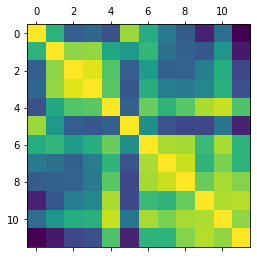

In [51]:
index = 10
plt.matshow(np.array(descriptors[index]) @ np.array(descriptors[index]).T)

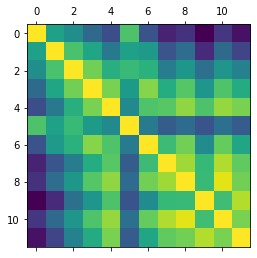

In [52]:
plt.matshow(-np.linalg.norm(predicted_points3d[index][None, :] - predicted_points3d[index][:, None], axis=2))

In [50]:
rmse_errors = []
for i in range(len(predicted_points3d)):
    mean_point = np.mean(predicted_points3d[i], axis=0)
    rmse_errors.append(np.sqrt(np.mean((mean_point - predicted_points3d[i]) ** 2)))
print(np.mean(rmse_errors))

0.11572510477789197


# Test other PnP method

In [139]:
ground_truth_positions = []
recovered_positions = []
for i in tqdm(range(len(TEST_KEYPOINT_MAP.keypoints))):
    x = models[0].predict(TEST_KEYPOINT_MAP.descriptors[i])
    y = models[1].predict(TEST_KEYPOINT_MAP.descriptors[i])
    z = models[2].predict(TEST_KEYPOINT_MAP.descriptors[i])
    points = np.array([x, y, z]).T
    recovered_positions.append(pnp_position(points, TEST_KEYPOINT_MAP.keypoints[i], 
                                                CAMERA_MATRIX, DIST_COEF))
    ground_truth_positions.append(matrix_from_position(TEST_KAPTURE_DATA.trajectories[i + 2001]["kinect_rgb"]))
ground_truth_positions = np.array(ground_truth_positions)
recovered_positions = np.array(recovered_positions)
calculate_errors(recovered_positions, np.linalg.inv(ground_truth_positions));


Mean position error: 0.540090101189215
Median position error: 0.41434628966847203
Mean rotation error: 21.01459535242398
Median rotation error: 13.259441501334859


In [109]:
def pnp_position_ransac(keypoints3d, keypoints, camera_matrix, dist_coef):
    found, rvec, tvec, _ = cv2.solvePnPRansac(keypoints3d, keypoints, camera_matrix, 
                                 dist_coef, flags=cv2.SOLVEPNP_AP3P)
    rotation = cv2.Rodrigues(rvec)[0]
    translation = -np.matrix(rotation).T * np.matrix(tvec)
    translation = np.array(translation)[:, 0]
    recovered_camera_position = np.zeros((4, 4))
    recovered_camera_position[:3, :3] = rotation.T
    recovered_camera_position[:3, 3] = translation
    recovered_camera_position[3, 3] = 1
    return recovered_camera_position

In [110]:
ground_truth_positions = []
recovered_positions = []
for i in tqdm(range(len(TEST_KEYPOINT_MAP.keypoints))):
    x = models[0].predict(TEST_KEYPOINT_MAP.descriptors[i])
    y = models[1].predict(TEST_KEYPOINT_MAP.descriptors[i])
    z = models[2].predict(TEST_KEYPOINT_MAP.descriptors[i])
    points = np.array([x, y, z]).T
    recovered_positions.append(pnp_position_ransac(points, TEST_KEYPOINT_MAP.keypoints[i], 
                                                CAMERA_MATRIX, DIST_COEF))
    ground_truth_positions.append(matrix_from_position(TEST_KAPTURE_DATA.trajectories[i + 2001]["kinect_rgb"]))
ground_truth_positions = np.array(ground_truth_positions)
recovered_positions = np.array(recovered_positions)
calculate_errors(recovered_positions, np.linalg.inv(ground_truth_positions));


Mean position error: 0.7837108397399971
Median position error: 0.552225342557916
Mean rotation error: 32.47920720190809
Median rotation error: 20.424747144768276


In [78]:
calculate_errors(recovered_positions, np.linalg.inv(ground_truth_positions));

Mean position error: 0.6723390529446542
Median position error: 0.47780689925428066
Mean rotation error: 32.936178402585156
Median rotation error: 17.489656250741938
